***
***

# Boston Housing Prices
### <font color='B43F26'> Deep Learning con Grandes Volúmenes de Datos (MBD) </font>

***
***

## Generalidades

***

### Objetivo

En esta notebook presentaremos el uso básico de las principales librerías "de alto nivel" de Python para el diseño de nuestras redes neuronales. Para ello, resolveremos un problema de aprendizaje supervisado, particularmente, de regresión. Buscaremos, además, analizar la influcencia de los distintos hiperparámetros asociados al entrenamiento.

### Desafío

Queremos predecir el precio de las casas en el área suburbana de Boston, MA. Para ello, utilizaremos un dataset con los siguientes predictores y respuesta:

* CRIM: per capita crime rate by town.
* ZN: proportion of residential land zoned for lots over 25,000 sq.ft.
* INDUS: proportion of non-retail business acres per town.
* CHAS: Charles River dummy variable (= 1 if tract bounds river; 0 otherwise).
* NOX: nitric oxides concentration (parts per 10 million).
* RM: average number of rooms per dwelling.
* AGE:proportion of owner-occupied units built prior to 1940.
* DIS: weighted distances to five Boston employment centres.
* RAD: index of accessibility to radial highways.
* TAX: full-value property-tax rate per \$10,000.
* PTRATIO: pupil-teacher ratio by town.
* B: 1000(Bk - 0.63)^2 where Bk is the proportion of blacks by town.
* LSTAT: % lower status of the population
* MEDV: Median value of owner-occupied homes in $1000's.

Tener presente que existen diversas versiones de este dataset. Por simplicidad en la carga de datos, nosotros utilizaremos la [versión propia](https://keras.io/api/datasets/boston_housing/) de Keras, mantenida por la Universisdad de Carnegie Mellon.

### Tarea

En base a tus pruebas y su análisis de resultados, deberás responder las siguientes preguntas:

1. ¿Qué función de *loss* seleccionó?, ¿por qué?
2. Describe las arquitecturas de red utilizadas.
3. ¿Cuáles son las principales apreciaciones y/o conclusiones que obtienes de la variación de hiperparámetros?


### Entrega

La entrega debe contener:

* Código generado.
* Presentación de resultados en sección homónima.
* Respuestas a preguntas de la tarea.

El formato de la entrega es la notebook + export HTML, todo en un archivo comprimido, utilizando el número de estudiante como nombre del mismo.

## Setup

***

### Librerías

In [ ]:
%pip install scikit-learn
# %pip install tensorflow
# %pip install --upgrade pip

Note: you may need to restart the kernel to use updated packages.


In [1]:
## Libraries

# TensorFlow
import tensorflow as tf

# Keras
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential, clone_model, model_from_json
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Activation, Dense
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.datasets import boston_housing

# Scikit
from sklearn.metrics import mean_absolute_error

# Mics
import numpy as np
import datetime
import os
from IPython.display import Image

### Funciones Auxiliares

*&lt;&lt; Agrega aquí todas las funciones adicionales que necesites para completar la tarea &gt;&gt;*

In [37]:
import os
import datetime
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.callbacks import TensorBoard
from sklearn.metrics import mean_absolute_error, mean_squared_error

def train_model(x_train, y_train, x_test, y_test,
                loss='mean_absolute_error',
                learn_rate=0.001,
                optimizer_type='adam',
                model_layers=None,
                epochs=500,
                batch_size=32,
                verbose=1,
                log_dir_prefix='logs/boston/demo_',
                error_metric=mean_absolute_error):

    if model_layers is None:
        model_layers = [
            Dense(4, input_shape=(x_train.shape[1],), name='dense_1'),
            Activation('relu', name='act_1'),
            Dense(1, name='dense_2'),
            Activation('relu', name='act_2')
        ]

    optimizers = {
        'adam': Adam(learning_rate=learn_rate),
        'sgd': SGD(learning_rate=learn_rate),
        'rmsprop': RMSprop(learning_rate=learn_rate)
    }
    optimizer = optimizers.get(optimizer_type, Adam(learning_rate=learn_rate))

    model = Sequential(model_layers, name='Model')

    model.compile(optimizer=optimizer,
                  loss=loss,
                  metrics=['mse', 'mae'])

    current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    log_dir = log_dir_prefix + current_time
    tb_callback = TensorBoard(log_dir, histogram_freq=1)

    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

    model.fit(x_train,
              y_train,
              validation_data=(x_test, y_test),
              batch_size=batch_size,
              epochs=epochs,
              verbose=verbose,
              callbacks=[tb_callback])

    y_test_pred = model.predict(x_test)

    error = error_metric(y_test, y_test_pred)

    print(f'Error (Test):\t {error}')

    return model,error




In [2]:
df = boston_housing.load_data()
type(df)
(x_train, y_train), (x_test, y_test) = boston_housing.load_data()
# Calculo de la media de los datos de entrenamiento
x_train_mean = np.mean(x_train, axis = 0)

# Restamos la media
x_train = x_train - x_train_mean
x_test = x_test - x_train_mean
# Calculo de la varianza
x_train_var = np.var(x_train, axis = 0)

# Calculo del desvío estandar (es la raiz cuadrada de la varianza)
x_train_desv = np.std(x_train, axis = 0)

# Dividimos sobre desvio estandar de los datos de entrenamiento, tanto x_train como x_test, ya que,
# para evaluar, debemos aplicar los parámetros aplicados sobre los datos de entrenamiento
x_train = x_train / x_train_desv
x_test = x_test / x_train_desv
loss = 'mean_absolute_error'
# Optimizer
learn_rate = .001
optimizer = Adam(learning_rate= learn_rate)
# Demo model
model_demo = Sequential(
    [
     Dense(4, input_shape = (13,), name='dense_1'),
     Activation('relu', name='act_1'),
     Dense(1, name='dense_2'),
     Activation('relu', name='act_2')
    ],
    name='Model_Demo'
)
# Training hyperparams
epochs = 500
batch_size = 32

# Compile the model
model_demo.compile(optimizer=optimizer,
                   loss=loss,
                   metrics=['mse','mae'])

# TB callbacks
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
TBLOGDIRS = {'demo': 'logs/boston/demo_'}
TBLOGDIRS = {k:v+current_time for (k,v) in TBLOGDIRS.items()}

# Training verbosity
VERBOSE = 1

# Train
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

model_demo.fit(x_train,
               y_train,
               validation_data = (x_test, y_test),
               batch_size=batch_size,
               epochs=epochs,
               verbose=VERBOSE,
               callbacks=TensorBoard(TBLOGDIRS['demo'], histogram_freq=1))

%tensorboard --logdir logs

# Get predictions
y_test_pred = model_demo.predict(x_test)

# Error
error = mean_absolute_error(y_test, y_test_pred)

print(f'Error (Test):\t {error}')

57026/57026 [==============================] - 0s 0us/step
Epoch 1/500
13/13 [==============================] - 5s 31ms/step - loss: 22.1124 - mse: 577.0992 - mae: 22.1124 - val_loss: 22.8485 - val_mse: 608.3307 - val_mae: 22.8485
Epoch 2/500
13/13 [==============================] - 0s 8ms/step - loss: 22.0345 - mse: 574.6201 - mae: 22.0345 - val_loss: 22.7813 - val_mse: 606.3403 - val_mae: 22.7813
Epoch 3/500
13/13 [==============================] - 0s 8ms/step - loss: 21.9446 - mse: 571.8939 - mae: 21.9446 - val_loss: 22.7061 - val_mse: 604.1545 - val_mae: 22.7061
Epoch 4/500
13/13 [==============================] - 0s 8ms/step - loss: 21.8485 - mse: 569.0069 - mae: 21.8485 - val_loss: 22.6168 - val_mse: 601.6784 - val_mae: 22.6168
Epoch 5/500
13/13 [==============================] - 0s 8ms/step - loss: 21.7427 - mse: 565.9990 - mae: 21.7427 - val_loss: 22.5224 - val_mse: 599.1359 - val_mae: 22.5224
Epoch 6/500
13/13 [==============================] - 0s 8ms/step - loss: 21.6287 - ms

UsageError: Line magic function `%tensorboard` not found.


### Variables Globales

In [4]:
# Google Colab
COLAB = True

## Intro

***

### Qué es Keras?

[Keras](https://keras.io/) es una librería open-source de Python desarrollada sobre Theanos y TensorFlow. Presenta una API sencilla para la generación, entrenamiento y evaluación de redes neuronales.

In [5]:
# Check Keras version
#keras.__version__

La documentación de Keras, la puedes encontrar [aquí](https://keras.io/api/).

### Qué es TensorBoard?

[TensorBoard](https://www.tensorflow.org/tensorboard) proporciona la visualización y las herramientas necesarias para experimentar con el aprendizaje automático. Permite:

* Seguir y visualizar métricas, como la pérdida y la exactitud.
* Visualizar el grafo del modelo (operaciones y capas).
* Ver histogramas de pesos, sesgos y otros tensores a medida que cambian con el tiempo.
* Proyectar incorporaciones en un espacio de menores dimensiones.
* Mostrar imágenes, texto y datos de audio.
* Crear perfiles de programas de TensorFlow.

In [7]:
# Load the TensorBoard notebook extension
if COLAB:
  %load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


## Qué necesitamos?

***

Como concepto general, para resolver un problema de machine learning necesitamos los siguientes elementos:

* Dataset.
* Función de costo.
* Método de optimización.
* Modelo.

En las siguientes secciones, iremos viendo cada uno de éstos.

MANUAL para PASAJE de notebook de colab a formato HTML (para quienes deseen hacer esto):

https://python.plainenglish.io/how-to-convert-google-colab-notebook-ipynb-to-html-ccfeda199246

### Dataset

A continuación, descargamos el dataset de "Boston Housing" y revisamos algunos detalles del mismo:

In [8]:
df = boston_housing.load_data()
type(df)

tuple

Una tupla es como una lista de elementos de diversos tipos (enteros, listas, etc.), pero, se define con paréntesis curvos, por ejemplo:

tupla = (n, cant_preds, cant_pruebas, mes_inicio_entrenamiento, anio_inicio_entrenamiento, lista1, lista2
)

lista = [n, cant_preds, lista1]

In [9]:
df

((array([[1.23247e+00, 0.00000e+00, 8.14000e+00, ..., 2.10000e+01,
          3.96900e+02, 1.87200e+01],
         [2.17700e-02, 8.25000e+01, 2.03000e+00, ..., 1.47000e+01,
          3.95380e+02, 3.11000e+00],
         [4.89822e+00, 0.00000e+00, 1.81000e+01, ..., 2.02000e+01,
          3.75520e+02, 3.26000e+00],
         ...,
         [3.46600e-02, 3.50000e+01, 6.06000e+00, ..., 1.69000e+01,
          3.62250e+02, 7.83000e+00],
         [2.14918e+00, 0.00000e+00, 1.95800e+01, ..., 1.47000e+01,
          2.61950e+02, 1.57900e+01],
         [1.43900e-02, 6.00000e+01, 2.93000e+00, ..., 1.56000e+01,
          3.76700e+02, 4.38000e+00]]),
  array([15.2, 42.3, 50. , 21.1, 17.7, 18.5, 11.3, 15.6, 15.6, 14.4, 12.1,
         17.9, 23.1, 19.9, 15.7,  8.8, 50. , 22.5, 24.1, 27.5, 10.9, 30.8,
         32.9, 24. , 18.5, 13.3, 22.9, 34.7, 16.6, 17.5, 22.3, 16.1, 14.9,
         23.1, 34.9, 25. , 13.9, 13.1, 20.4, 20. , 15.2, 24.7, 22.2, 16.7,
         12.7, 15.6, 18.4, 21. , 30.1, 15.1, 18.7,  9.6, 31.

In [10]:
# Boston Housing dataset
(x_train, y_train), (x_test, y_test) = boston_housing.load_data()

In [11]:
print('Largo x_train:',len(x_train))
print('Largo x_test:',len(x_test))

print('Largo y_train:',len(y_train))
print('Largo y_train:',len(y_test))


Largo x_train: 404
Largo x_test: 102
Largo y_train: 404
Largo y_train: 102


In [12]:
# BH details
print('Boston Housing Dataset')
print('******************************************')
print(f'Training data:\t {x_train.shape}')
print(f'Test data:\t {x_test.shape}')

Boston Housing Dataset
******************************************
Training data:	 (404, 13)
Test data:	 (102, 13)


De acuerdo con esto, tenemos una división train-test de aproximadamente 80-20%.

#### Normalización

Dado que los inputs pueden tener escalas muy disímiles, los métodos de optimización como el descenso del gradiente estocástico (SGD) pueden presentar inconvenientes e, inclusive, nunca alcanzar el mínimo de la función de *loss*. Esto puede acarrear predicciones con errores elevados, además de llevar gran tiempo en converger.

Por lo anterior, se suele utilizar la normalización de los inputs (previo al entrenamiento, claro está). Es importante mencionar que esto no siempre es necesario (por diferentes motivos); debe analizarse caso a caso.



In [13]:
# NOTA:Siempre en Python axis = 0 son filas, y axis = 1 son columnas.

# Calculo de la media de los datos de entrenamiento
x_train_mean = np.mean(x_train, axis = 0)

# Restamos la media
x_train = x_train - x_train_mean
x_test = x_test - x_train_mean

In [14]:
# Calculo de la varianza
x_train_var = np.var(x_train, axis = 0)

# Calculo del desvío estandar (es la raiz cuadrada de la varianza)
x_train_desv = np.std(x_train, axis = 0)

# Dividimos sobre desvio estandar de los datos de entrenamiento, tanto x_train como x_test, ya que,
# para evaluar, debemos aplicar los parámetros aplicados sobre los datos de entrenamiento
x_train = x_train / x_train_desv
x_test = x_test / x_train_desv

NOTESE que no estandarizamos y_test, y_train (y_train podria haberse estandarizado, pero después, los resultados de las predicciones deberían desestandarizarse)


### Función de Costo

Como hemos visto en el curso, la función de costo se define como

$$J(W)=\mathbb{E}\left[ L(W) \right]$$

entre todos los individuos, siendo $W$ los pesos de la NN. Por lo tanto, necesitamos definir/seleccionar previamente la función de *loss*, $L(W)$.

Dado que se trata de un problema de regresión, debe utilizarse una función de *loss* adecuada. Existen varias opciones para la selección; [aquí](https://machinelearningmastery.com/how-to-choose-loss-functions-when-training-deep-learning-neural-networks/) puedes encontrar un compendio con algunas de ellas, y [aquí](https://keras.io/api/losses/) la referencia de la documentación de Keras.

En nuestra NN de ejemplo, utilizaremos **MAE** (Mean Absolute Error).

In [15]:
# Loss function
loss = 'mean_absolute_error'

### Método de Optimización

Los métodos de optimización, comúnmente llamados "optimizadores", son aquellos que utilizamos para encontrar iterativamente el vector $\hat{W}$ minimiza el costo, es decir:

$$\hat{W}=\arg\min_{W} J(W)$$

Existen diferentes optimizadores, cada uno con sus pros & cons; [aquí](https://towardsdatascience.com/optimizers-for-training-neural-network-59450d71caf6) puedes encontrar un breve análisis de ellos, y [aquí](https://keras.io/api/optimizers/) la referencia de la documentación de Keras.

En nuestra NN de ejemplo, utilizaremos **Adam** (Adaptive Moment Estimation). Deberemos seleccionar también un valor para el *learning rate* $\eta$. Por ahora, utilizaremos el valor por defecto: $0.001$.

In [16]:
# Optimizer
learn_rate = .001
optimizer = Adam(learning_rate= learn_rate)

### Modelo

En nuestro caso, el modelo responderá a una NN cuya arquitectura debemos definir. La misma constará de diferentes capas, funciones de activación, etc.

En Keras existen varias estrategias para definir un modelo; puedes encontrar [aquí](https://keras.io/api/models/) las diferentes maneras. La más sencilla es la de ir agregando las capas de la NN de forma **secuencial** mediante un objeto de Keras llamado ``Sequential``.

Para comenzar a fijar ideas, definiremos un modelo de nombre "Demo". Para probar diferentes arquitecturas y realizar análisis interesantes, puedes basarte en el mismo.

#### Modelo "Demo"

Este modelo consistirá en una fully-connected (FC) NN, para la cual utilizaremos una input layer, una hidden layer y una output layer. Esta FC-NN tiene la siguiente arquitectura:

In [ ]:
# Show NN
Image('nn.png')

In [ ]:
Image('nn_model.png')

Las múltiples capas pueden agregarse de diferentes maneras utilizando funciones de Keras. Veremos una de ellas pero sugerimos revises que otras opciones para tener un mejor manejo de la API.

In [19]:
# Demo model
model_demo = Sequential(
    [
     Dense(4, input_shape = (13,), name='dense_1'),
     Activation('relu', name='act_1'),
     Dense(1, name='dense_2'),
     Activation('relu', name='act_2')
    ],
    name='Model_Demo'
)

Verifiquemos que el modelo generado, sea el buscado:

In [20]:
# Model summary
model_demo.summary()

Model: "Model_Demo"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1 (Dense)             (None, 4)                 56        
                                                                 
 act_1 (Activation)          (None, 4)                 0         
                                                                 
 dense_2 (Dense)             (None, 1)                 5         
                                                                 
 act_2 (Activation)          (None, 1)                 0         
                                                                 
Total params: 61 (244.00 Byte)
Trainable params: 61 (244.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [21]:
#model_demo1 = Sequential()
#model_demo1.add(Dense(units = 8, activation ='relu', input_shape=(13,)))
#model_demo1.add(Dense(units = 1, activation ='relu'))
#model_demo1.summary()

La columna ``Param #`` indica la cantidad de parámetros (i.e. pesos) a obtener durante el entrenamiento de la NN. Para las ``Dense`` esto se calcula como $(input + bias) \times output$:

$$
\begin{align*}
  dense\_1 &= (13 + 1)\times 8=112\\
  dense\_2 &= (8 + 1)\times 1=9
\end{align*}
$$

Notar que las activaciones son simplemente funciones que se aplican sobre el producto matricial $XW$, por lo que no cuentan con parámetros para entrenar.

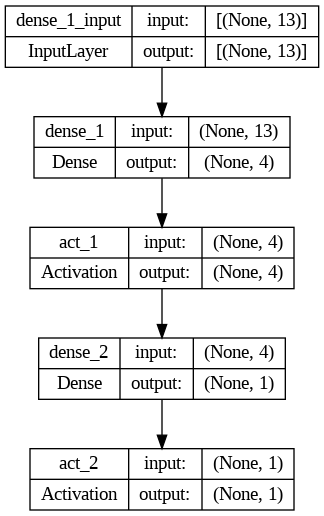

In [22]:
tf.keras.utils.plot_model(model_demo, show_shapes=True)

In [23]:
# %pip install pydot
# !pip install graphviz

<a id=entrenamiento></a>

## Entrenamiento
***

Ya tenemos todo lo necesario para entrenar nuestra NN. Debemos ahora revisar los parámetros para el entrenamiento, los cuales son:

* Learning Rate (ya configurado en el optimizer).
* Cantidad de Epochs.
* Tamaño de Batch.

Para nuestro ejemplo, utilizaremos valores fijos para cada uno de ellos. En tus pruebas, esperamos que evalúes el impacto de otros valores para los hiperparámetros.

In [24]:
# Training hyperparams
epochs = 500
batch_size = 32

Antes de iniciar el entrenamiento, debemos indicarle al modelo cuáles son algunos de los parámetros que generamos anteriormente. Para ello se realiza lo que se conoce como "compilar el modelo". Veamos cómo hacerlo con Keras:

In [25]:
# Compile the model
model_demo.compile(optimizer=optimizer,
                   loss=loss,
                   metrics=['mse','mae'])

In [26]:
print("cantidad de datos de x_train:", len(x_train))
print("cantidad de datos de y_train:",len(y_train))

cantidad de datos de x_train: 404
cantidad de datos de y_train: 404


Finalmente, entrenamos el modelo:

In [27]:
# TB callbacks
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
TBLOGDIRS = {'demo': 'logs/boston/demo_'}
TBLOGDIRS = {k:v+current_time for (k,v) in TBLOGDIRS.items()}

# Training verbosity
VERBOSE = 1

In [28]:
# Train
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

model_demo.fit(x_train,
               y_train,
               validation_data = (x_test, y_test),
               batch_size=batch_size,
               epochs=epochs,
               verbose=VERBOSE,
               callbacks=TensorBoard(TBLOGDIRS['demo'], histogram_freq=1))

Epoch 1/500
13/13 [==============================] - 1s 17ms/step - loss: 22.1991 - mse: 578.8869 - mae: 22.1991 - val_loss: 22.9110 - val_mse: 609.7660 - val_mae: 22.9110
Epoch 2/500
13/13 [==============================] - 0s 8ms/step - loss: 22.1563 - mse: 577.2319 - mae: 22.1563 - val_loss: 22.8696 - val_mse: 608.1613 - val_mae: 22.8696
Epoch 3/500
13/13 [==============================] - 0s 8ms/step - loss: 22.1106 - mse: 575.4510 - mae: 22.1106 - val_loss: 22.8250 - val_mse: 606.4554 - val_mae: 22.8250
Epoch 4/500
13/13 [==============================] - 0s 8ms/step - loss: 22.0610 - mse: 573.5012 - mae: 22.0610 - val_loss: 22.7748 - val_mse: 604.5538 - val_mae: 22.7748
Epoch 5/500
13/13 [==============================] - 0s 8ms/step - loss: 22.0043 - mse: 571.2269 - mae: 22.0043 - val_loss: 22.7209 - val_mse: 602.5089 - val_mae: 22.7209
Epoch 6/500
13/13 [==============================] - 0s 8ms/step - loss: 21.9418 - mse: 568.7080 - mae: 21.9418 - val_loss: 22.6615 - val_mse: 6

In [29]:
# # Train
# model_demo.fit(x_train,
#                y_train,
#                validation_split = 0.2,
#                batch_size=batch_size,
#                epochs=epochs,
#                verbose=1,
#                callbacks=TensorBoard(TBLOGDIRS['demo'], histogram_freq=1))

In [ ]:
if COLAB:
  # Reload TB
  %reload_ext tensorboard

  # Colab: Init TB
  %tensorboard --logdir logs

In [48]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

El error cometido en test es:

In [32]:
# Get predictions
y_test_pred = model_demo.predict(x_test)

# Error
error = mean_absolute_error(y_test, y_test_pred)

print(f'Error (Test):\t {error}')

4/4 [==============================] - 0s 2ms/step
Error (Test):	 3.3494803120108214


In [ ]:
y_test_pred

# Trabajo

## Hiperparametros

In [49]:
import os
import datetime
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.callbacks import TensorBoard
from sklearn.metrics import mean_absolute_error, mean_squared_error

def train_model(x_train, y_train, x_test, y_test,
                loss='mean_absolute_error',
                learn_rate=0.001,
                optimizer_type='adam',
                model_layers=None,
                epochs=200,
                batch_size=32,
                verbose=1,
                log_dir_prefix='logs/boston/demo_',
                error_metric=mean_absolute_error):

    if model_layers is None:
        model_layers = [
            Dense(4, input_shape=(x_train.shape[1],), name='dense_1'),
            Activation('relu', name='act_1'),
            Dense(1, name='dense_2'),
            Activation('relu', name='act_2')
        ]

    optimizers = {
        'adam': Adam(learning_rate=learn_rate),
        'sgd': SGD(learning_rate=learn_rate),
        'rmsprop': RMSprop(learning_rate=learn_rate)
    }
    optimizer = optimizers.get(optimizer_type, Adam(learning_rate=learn_rate))

    model = Sequential(model_layers, name='Model')

    model.compile(optimizer=optimizer,
                  loss=loss,
                  metrics=['mse', 'mae'])

    current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    log_dir = log_dir_prefix + current_time
    tb_callback = TensorBoard(log_dir, histogram_freq=1)

    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

    model.fit(x_train,
              y_train,
              validation_data=(x_test, y_test),
              batch_size=batch_size,
              epochs=epochs,
              verbose=verbose,
              callbacks=[tb_callback])

    y_test_pred = model.predict(x_test)

    error = error_metric(y_test, y_test_pred)

    print(f'Error (Test):\t {error}')

    return model,error

In [ ]:
losses = ['mean_squared_error', 'huber_loss']
optimizers = ['adam', 'sgd', 'rmsprop']
learn_rates = [0.001, 0.01]
batch_sizes = [32, 64]

results = {}

for loss in losses:
    for opt in optimizers:
        for lr in learn_rates:
            for batch in batch_sizes:
                model_name = f"{loss}_{opt}_lr{lr}_batch{batch}"
                _, error = train_model(x_train, y_train, x_test, y_test,
                                       loss=loss,
                                       optimizer_type=opt,
                                       learn_rate=lr,
                                       batch_size=batch)
                results[model_name] = error
                print()
                print(f"Model {model_name} - Error: {error}")


## Arquitecturas de redes

In [53]:
model = Sequential([
    Dense(64, activation='relu', input_shape=(13,)),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'),
    Dense(1)
])

learn_rate = 0.001
optimizer = Adam(learning_rate=learn_rate)

model.compile(optimizer=optimizer,
                   loss='mean_absolute_error',
                   metrics=['mse', 'mae'])

current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_dir = os.path.join('logs', 'boston', 'deep_' + current_time)
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

epochs = 100  # Reducido para que sea más rápido, pero puedes ajustarlo según tus necesidades
batch_size = 32

model.fit(x_train,
               y_train,
               validation_data=(x_test, y_test),
               batch_size=batch_size,
               epochs=epochs,
               callbacks=[tensorboard_callback])

y_test_pred = model.predict(x_test)
error = mean_absolute_error(y_test, y_test_pred)
print(f'Error (Test):\t {error}')

Epoch 1/100
13/13 [==============================] - 2s 21ms/step - loss: 22.1961 - mse: 578.0297 - mae: 22.1961 - val_loss: 22.4003 - val_mse: 585.0772 - val_mae: 22.4003
Epoch 2/100
13/13 [==============================] - 0s 10ms/step - loss: 21.1166 - mse: 530.2632 - mae: 21.1166 - val_loss: 20.9816 - val_mse: 524.2980 - val_mae: 20.9816
Epoch 3/100
13/13 [==============================] - 0s 10ms/step - loss: 19.0422 - mse: 448.7409 - mae: 19.0422 - val_loss: 18.0295 - val_mse: 410.9229 - val_mae: 18.0295
Epoch 4/100
13/13 [==============================] - 0s 10ms/step - loss: 15.0701 - mse: 307.9706 - mae: 15.0701 - val_loss: 13.0939 - val_mse: 233.4291 - val_mae: 13.0939
Epoch 5/100
13/13 [==============================] - 0s 10ms/step - loss: 9.1674 - mse: 142.0610 - mae: 9.1674 - val_loss: 7.8355 - val_mse: 102.1771 - val_mae: 7.8355
Epoch 6/100
13/13 [==============================] - 0s 10ms/step - loss: 6.8432 - mse: 83.5582 - mae: 6.8432 - val_loss: 6.5911 - val_mse: 73.4

In [54]:
model2 = Sequential([
    Dense(128, activation='relu', input_shape=(13,)),
    Dense(64, activation='relu'),
    Dense(1)
])

learn_rate = 0.001
optimizer = Adam(learning_rate=learn_rate)

model2.compile(optimizer=optimizer,
                   loss='mean_absolute_error',
                   metrics=['mse', 'mae'])

current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_dir = os.path.join('logs', 'boston', 'deep_' + current_time)
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

epochs = 100  # Reducido para que sea más rápido, pero puedes ajustarlo según tus necesidades
batch_size = 32

model2.fit(x_train,
               y_train,
               validation_data=(x_test, y_test),
               batch_size=batch_size,
               epochs=epochs,
               callbacks=[tensorboard_callback])

y_test_pred = model2.predict(x_test)
error = mean_absolute_error(y_test, y_test_pred)
print(f'Error (Test):\t {error}')

Epoch 1/100
13/13 [==============================] - 2s 21ms/step - loss: 21.2516 - mse: 533.5681 - mae: 21.2516 - val_loss: 20.7766 - val_mse: 512.7439 - val_mae: 20.7766
Epoch 2/100
13/13 [==============================] - 0s 9ms/step - loss: 18.9335 - mse: 441.6140 - mae: 18.9335 - val_loss: 17.8821 - val_mse: 402.4035 - val_mae: 17.8821
Epoch 3/100
13/13 [==============================] - 0s 10ms/step - loss: 15.4498 - mse: 319.8055 - mae: 15.4498 - val_loss: 13.9732 - val_mse: 261.2137 - val_mae: 13.9732
Epoch 4/100
13/13 [==============================] - 0s 9ms/step - loss: 11.0772 - mse: 187.9330 - mae: 11.0772 - val_loss: 9.6038 - val_mse: 133.7289 - val_mae: 9.6038
Epoch 5/100
13/13 [==============================] - 0s 9ms/step - loss: 7.4129 - mse: 96.3703 - mae: 7.4129 - val_loss: 7.2593 - val_mse: 88.5732 - val_mae: 7.2593
Epoch 6/100
13/13 [==============================] - 0s 9ms/step - loss: 6.0550 - mse: 66.8091 - mae: 6.0550 - val_loss: 6.1348 - val_mse: 64.4510 - va

In [55]:
from tensorflow.keras.layers import Dropout

model3 = Sequential([
    Dense(64, activation='relu', input_shape=(13,)),
    Dropout(0.5),
    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(1)
])

learn_rate = 0.001
optimizer = Adam(learning_rate=learn_rate)

model3.compile(optimizer=optimizer,
                   loss='mean_absolute_error',
                   metrics=['mse', 'mae'])

current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_dir = os.path.join('logs', 'boston', 'deep_' + current_time)
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

epochs = 100  # Reducido para que sea más rápido, pero puedes ajustarlo según tus necesidades
batch_size = 32

model3.fit(x_train,
               y_train,
               validation_data=(x_test, y_test),
               batch_size=batch_size,
               epochs=epochs,
               callbacks=[tensorboard_callback])

y_test_pred = model3.predict(x_test)
error = mean_absolute_error(y_test, y_test_pred)
print(f'Error (Test):\t {error}')

Epoch 1/100
13/13 [==============================] - 1s 20ms/step - loss: 21.8675 - mse: 560.3857 - mae: 21.8675 - val_loss: 21.8980 - val_mse: 557.8806 - val_mae: 21.8980
Epoch 2/100
13/13 [==============================] - 0s 9ms/step - loss: 20.6075 - mse: 504.2293 - mae: 20.6075 - val_loss: 20.4378 - val_mse: 492.6815 - val_mae: 20.4378
Epoch 3/100
13/13 [==============================] - 0s 9ms/step - loss: 18.8696 - mse: 433.0319 - mae: 18.8696 - val_loss: 18.4009 - val_mse: 409.7557 - val_mae: 18.4009
Epoch 4/100
13/13 [==============================] - 0s 9ms/step - loss: 16.2740 - mse: 339.6223 - mae: 16.2740 - val_loss: 15.4477 - val_mse: 305.7552 - val_mae: 15.4477
Epoch 5/100
13/13 [==============================] - 0s 9ms/step - loss: 13.4111 - mse: 249.0735 - mae: 13.4111 - val_loss: 11.8156 - val_mse: 193.8764 - val_mae: 11.8156
Epoch 6/100
13/13 [==============================] - 0s 9ms/step - loss: 9.6438 - mse: 149.4217 - mae: 9.6438 - val_loss: 8.6826 - val_mse: 112.

In [56]:
from tensorflow.keras.layers import BatchNormalization

model4 = Sequential([
    Dense(64, activation='relu', input_shape=(13,)),
    BatchNormalization(),
    Dense(64, activation='relu'),
    BatchNormalization(),
    Dense(1)
])

learn_rate = 0.001
optimizer = Adam(learning_rate=learn_rate)

model4.compile(optimizer=optimizer,
                   loss='mean_absolute_error',
                   metrics=['mse', 'mae'])

current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_dir = os.path.join('logs', 'boston', 'deep_' + current_time)
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

epochs = 100  # Reducido para que sea más rápido, pero puedes ajustarlo según tus necesidades
batch_size = 32

model4.fit(x_train,
               y_train,
               validation_data=(x_test, y_test),
               batch_size=batch_size,
               epochs=epochs,
               callbacks=[tensorboard_callback])

y_test_pred = model4.predict(x_test)
error = mean_absolute_error(y_test, y_test_pred)
print(f'Error (Test):\t {error}')


Epoch 1/100
13/13 [==============================] - 2s 27ms/step - loss: 22.3289 - mse: 588.3470 - mae: 22.3289 - val_loss: 23.0199 - val_mse: 614.4193 - val_mae: 23.0199
Epoch 2/100
13/13 [==============================] - 0s 13ms/step - loss: 22.1653 - mse: 581.1268 - mae: 22.1653 - val_loss: 22.7905 - val_mse: 603.9849 - val_mae: 22.7905
Epoch 3/100
13/13 [==============================] - 0s 13ms/step - loss: 21.9705 - mse: 573.2798 - mae: 21.9705 - val_loss: 22.5244 - val_mse: 592.0000 - val_mae: 22.5244
Epoch 4/100
13/13 [==============================] - 0s 13ms/step - loss: 21.7374 - mse: 562.1855 - mae: 21.7374 - val_loss: 22.2191 - val_mse: 578.4189 - val_mae: 22.2191
Epoch 5/100
13/13 [==============================] - 0s 13ms/step - loss: 21.4609 - mse: 549.5653 - mae: 21.4609 - val_loss: 21.8664 - val_mse: 562.9541 - val_mae: 21.8664
Epoch 6/100
13/13 [==============================] - 0s 14ms/step - loss: 21.1373 - mse: 536.9794 - mae: 21.1373 - val_loss: 21.4676 - val_m

## Resultados

***

El modelo 1 fue el que dio mejores resultados con un error de test del 2.6448. Analizando las epochs, el error de validación es apenas más alto que el de entrenamiento, por lo que parecen no estar sobreajustando. Esto indicaría un buen ajuste por parte del modelo.
El modelo con Dropout (modelo3) es el que tiene más error en comparación al resto, por lo que quizás el Dropout haya sido demasiado alto. Ajustando mejor quizás pueda dar buenos resultados.  
La cantidad de épocas es baja para contrastar los modelos entre sí principalmente, pero también seguramente puedan mejorar un poco los modelos si siguen entrenando.

*&lt;&lt; Completar &gt;&gt;*

## Preguntas

***

#### 1. ¿Qué función de *loss* seleccionó?, ¿por qué?

Se eligió el mae porque es una medida directa de cuanto le esta errando el modelo, es decir está en las mismas unidades que la variable objetivo. En estos casos donde se esta contrastando por ejemplo contra el precio de una casa, hace mucho sentido esta medida de error para poder comprender el error cometido por el modelo.
MAE es más sensible a outliers, por lo que en este caso dado que hay casas con precios exorbitantes por razones que las variables del modelo pueden no capturar puede llegar a tener sentido esta medida.

#### 2. Describe las arquitecturas de red utilizadas

**Modelo 1**

Estructura:
- Capa de entrada: 64 neuronas con función de activación ReLU.
- Capa oculta 1: 64 neuronas con función de activación ReLU.
- Capa oculta 2: 32 neuronas con función de activación ReLU.
- Capa de salida: 1 neurona (ya que es una tarea de regresión).

**Modelo 2**

Estructura:
- Capa de entrada: 128 neuronas con función de activación ReLU.
- Capa oculta: 64 neuronas con función de activación ReLU.
- Capa de salida: 1 neurona.

**Modelo 3**

Estructura:
- Capa de entrada: 64 neuronas con función de activación ReLU.
- Dropout: 50% de probabilidad de apagar neuronas.
- Capa oculta 1: 64 neuronas con función de activación ReLU.
- Dropout: 50% de probabilidad de apagar neuronas.
- Capa de salida: 1 neurona.

**Modelo 4**

Estructura:
- Capa de entrada: 64 neuronas con función de activación ReLU.
- Batch Normalization: Normaliza las activaciones.
- Capa oculta: 64 neuronas con función de activación ReLU.
- Batch Normalization: Normaliza las activaciones.
- Capa de salida: 1 neurona.

#### 3. ¿Cuáles son las principales apreciaciones y/o conclusiones que obtienes de la variación de hiperparámetros?

En líneas generales la variación de la función de pérdida puede cambiar el enfoque de penalización del entrenamiento entonces por ejemplo con MSE penaliza error grandes por tomar el cuadrado de la diferencia. La métrica de Huber fue interesante ya que combina el error MAE y el error MSE por lo que puede ser una alternativa interesante para lograr una mejor solución a las medidas individuales.
Respecto de los optimizadores Adam y RMSprop fueron los que resultaron más fácil de usar, el resto daban medidas más dispares.
La tasa de aprendizaje de lo observado aquí no trajo grandes diferencias pero no se exploro en profundidad en esta tarea, según la bibliografía y otros experimentos puede causar que el modelo no converja o no se estabilice hacia la solución.
Nuevamente en el tamaño de lote no vi una gran diferencia pero según la bibliografía puede causar una diferencia significativa en el rendimiento si no se balancea adecuadamente la velocidad de entrenamiento y la precisión del modelo. Lotes más pequeuños deberían dar una convergencia más segura (aunque mas lenta).